In [1]:
import cv2
import pandas as pd
import numpy as np
import os
import math
import json

from pdf2image import convert_from_path
from PIL import Image
from matplotlib import pyplot as plt

In [37]:
#### 최신버전
def convert_pdf_folder_to_images(pdf_folder, output_folder, chk = False):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    for filename in os.listdir(pdf_folder):
        if filename.endswith('.pdf'):
            pdf_path = os.path.join(pdf_folder, filename)
            images = convert_from_path(pdf_path)
            base_filename = os.path.splitext(filename)[0]
            
            for page_num, img in enumerate(images):
                if page_num == 0:
                    left_num = len(images)*2
                    right_num = 1
                else:
                    left_num = right_num + 1
                    right_num = left_num + 1
                    
                output_path = os.path.join(output_folder, f"{base_filename}_page_{page_num + 1}.jpg")
                img.save(output_path, 'JPEG')
                
                if chk:
                    width, height = img.size
                    width -= 20
                    height -= 20
                    left_half = img.crop((20, 20, width // 2, height))
                    right_half = img.crop((width // 2, 20, width, height))
                else:
                    width, height = img.size
                    left_half = img.crop((0, 0, width // 2, height))
                    right_half = img.crop((width // 2, 0, width, height))
                    
                # left_half_path = os.path.join(output_folder, f"{base_filename}_page_{page_num + 1}_left.jpg")
                # right_half_path = os.path.join(output_folder, f"{base_filename}_page_{page_num + 1}_right.jpg")
                left_half_path = os.path.join(output_folder, f"{base_filename}_{left_num}.jpg")
                right_half_path = os.path.join(output_folder, f"{base_filename}_{right_num}.jpg")
                
                left_half.save(left_half_path, 'JPEG')
                right_half.save(right_half_path, 'JPEG')
                
# pdf_folder = './scan/datas/pdf'  # PDF 파일이 있는 폴더 경로
# output_folder = './scan/datas/pdf/divided/t2'  # 출력 이미지 파일을 저장할 폴더 경로
pdf_folder = './scan/datas/pdf/TEST'  # PDF 파일이 있는 폴더 경로
output_folder = './scan/datas/pdf/divided/test'  # 출력 이미지 파일을 저장할 폴더 경로

# convert_pdf_folder_to_images(pdf_folder, output_folder) # chk : True -> 마킹된 검사지 
convert_pdf_folder_to_images(pdf_folder, output_folder, chk = True) # chk : True -> 마킹된 검사지 

좌상단: (57, 27)
우상단: (1629, 27)
좌하단: (55, 2280)
우하단: (1631, 2279)


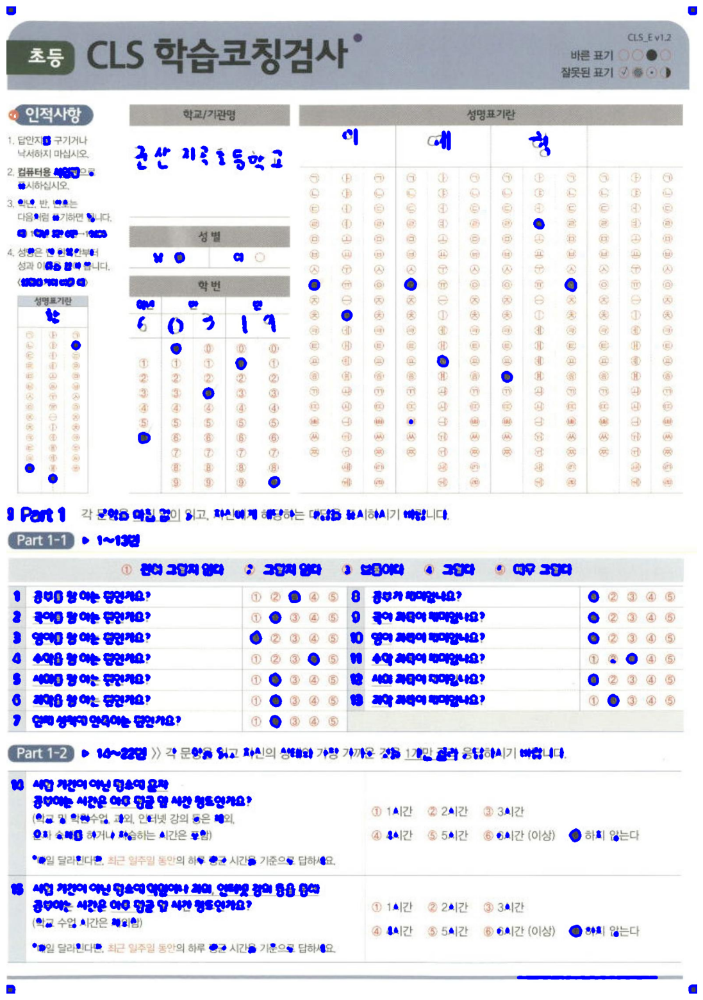

좌상단: (41, 27)
우상단: (1612, 28)
좌하단: (34, 2276)
우하단: (1611, 2276)


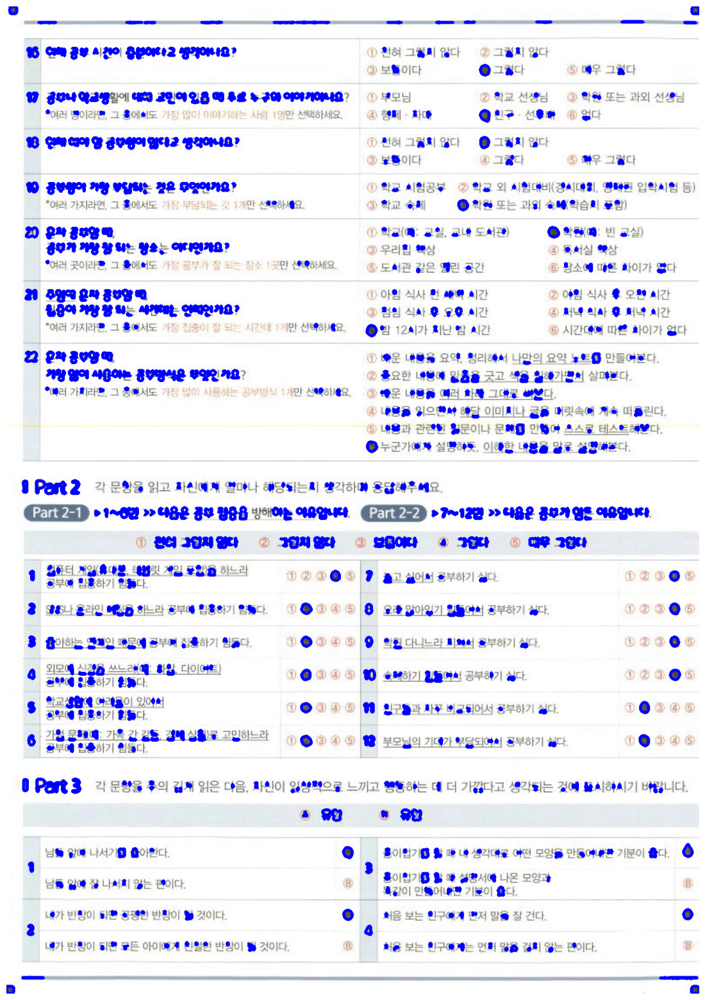

좌상단: (60, 26)
우상단: (1637, 24)
좌하단: (59, 2276)
우하단: (1641, 2275)


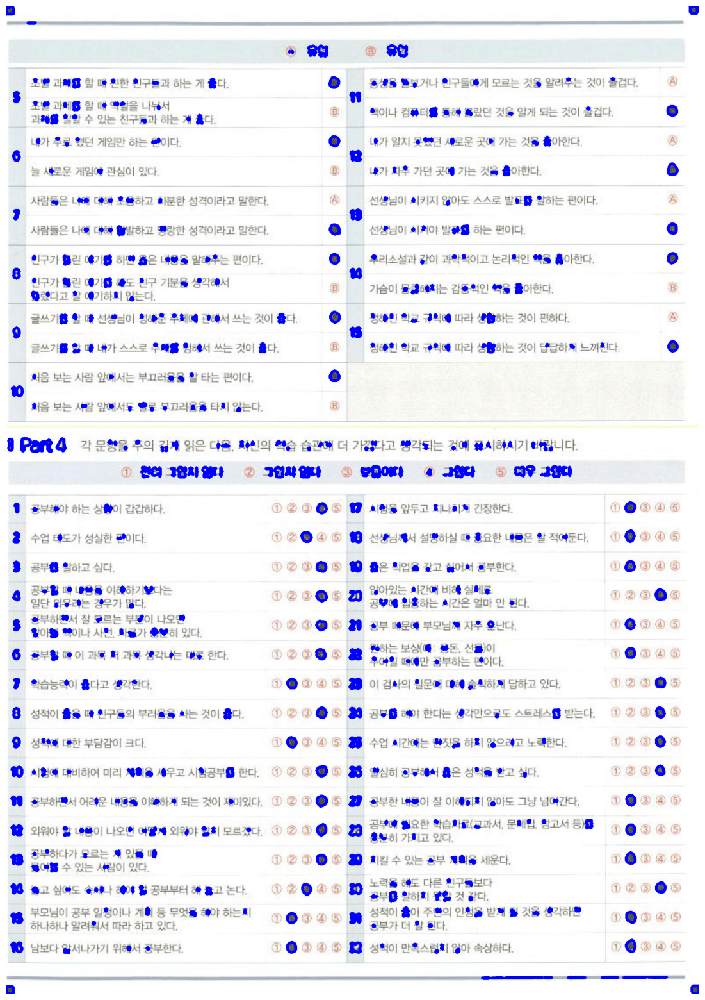

좌상단: (31, 26)
우상단: (1609, 28)
좌하단: (24, 2276)
우하단: (1608, 2280)


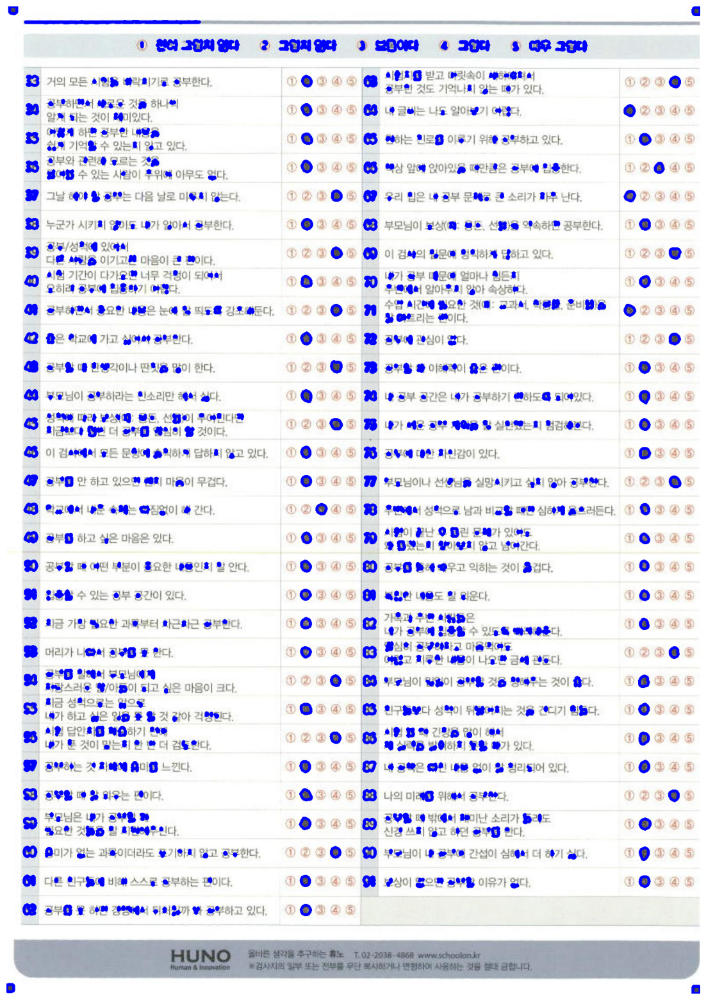

좌상단: (58, 33)
우상단: (1630, 31)
좌하단: (58, 2282)
우하단: (1635, 2282)


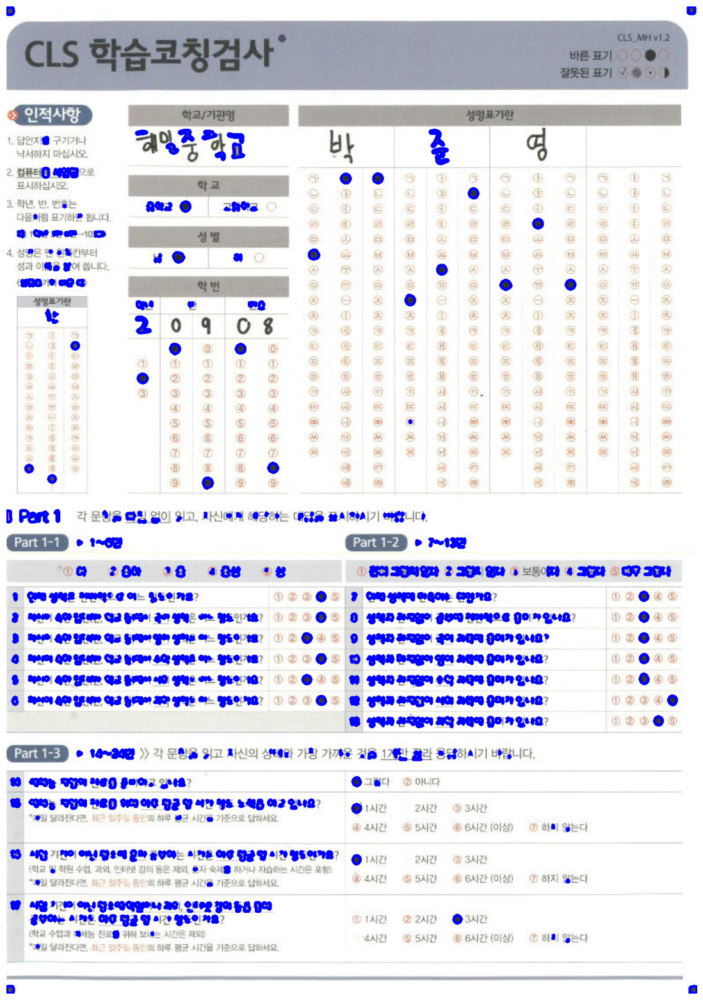

좌상단: (40, 27)
우상단: (1610, 26)
좌하단: (30, 2276)
우하단: (1609, 2278)


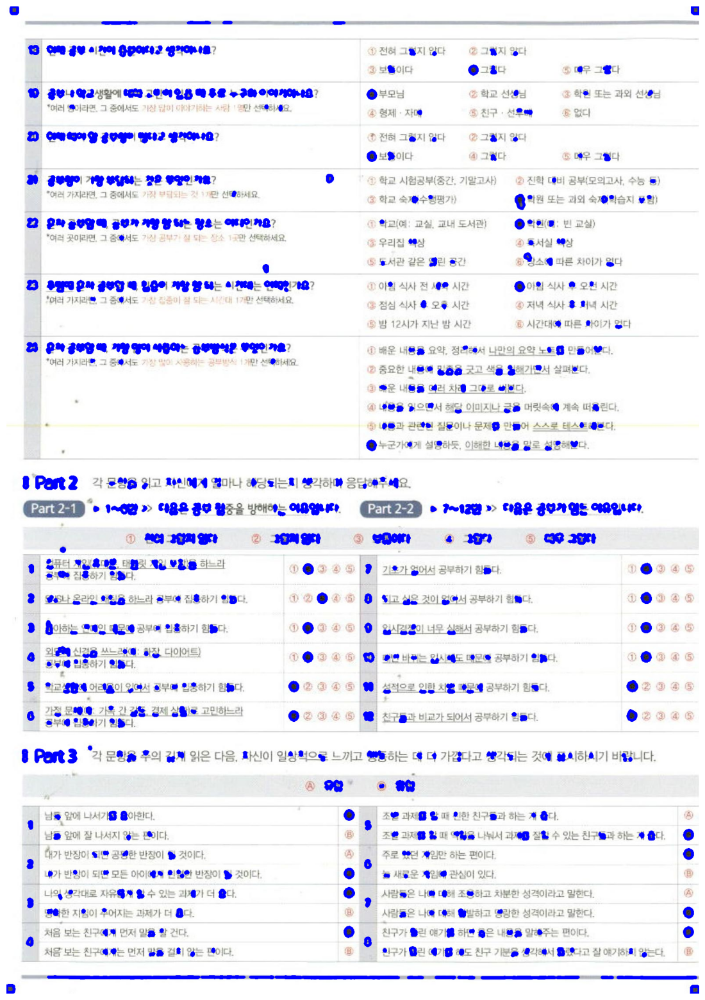

좌상단: (58, 25)
우상단: (1641, 26)
좌하단: (57, 2278)
우하단: (1641, 2276)


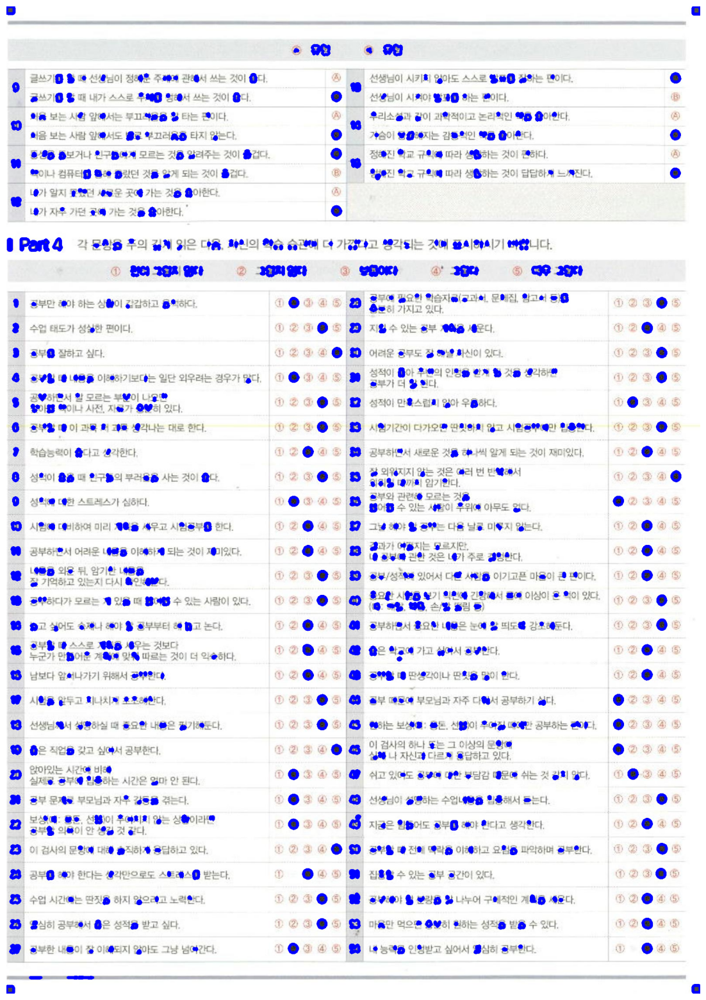

좌상단: (27, 31)
우상단: (1610, 33)
좌하단: (25, 2281)
우하단: (1610, 2282)


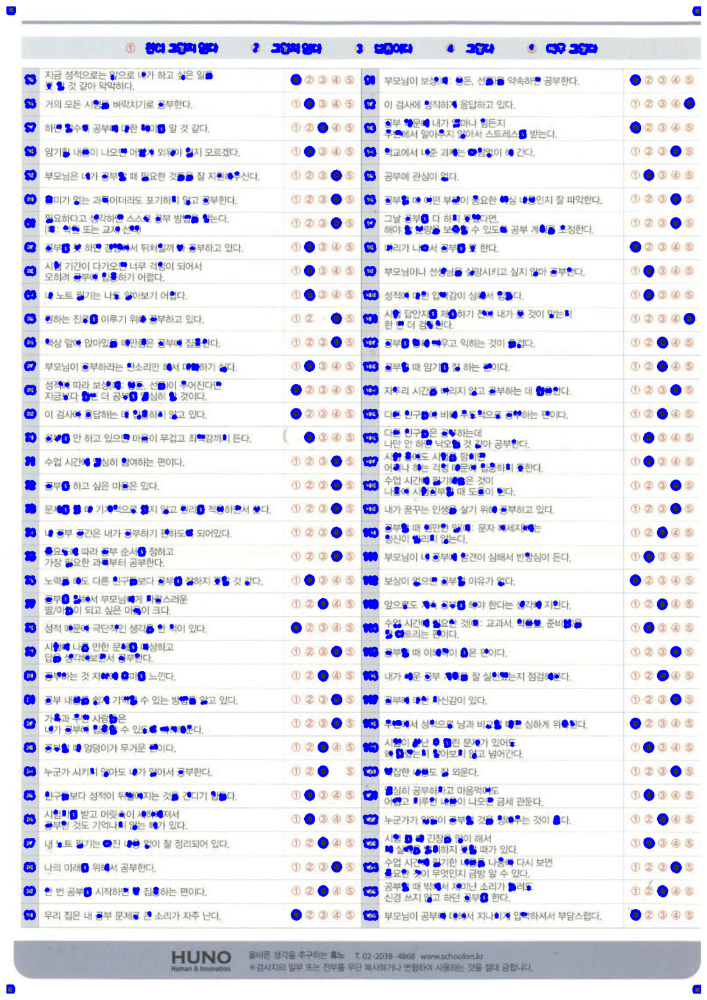

좌상단: (62, 32)
우상단: (1635, 31)
좌하단: (61, 2279)
우하단: (1638, 2281)


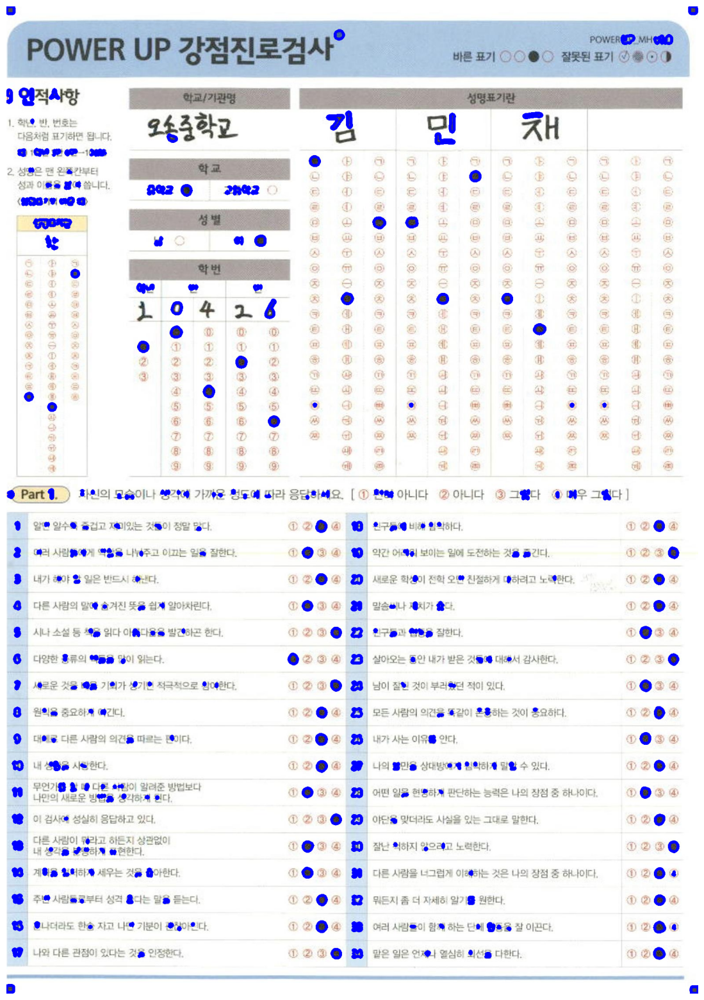

좌상단: (35, 30)
우상단: (1604, 30)
좌하단: (26, 2278)
우하단: (1604, 2280)


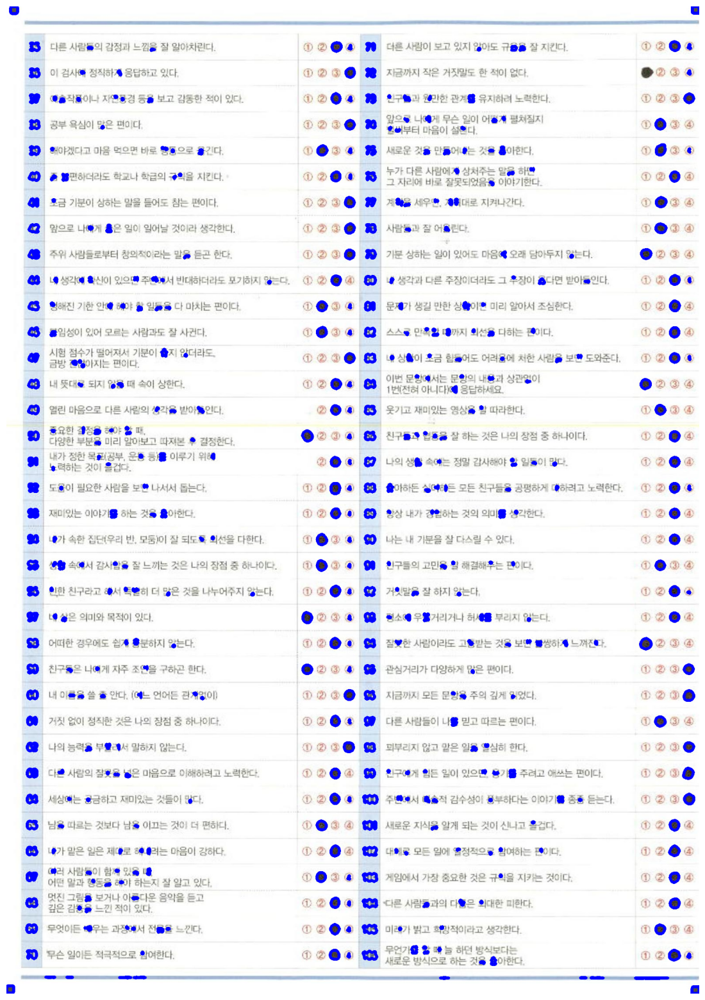

좌상단: (52, 29)
우상단: (1633, 30)
좌하단: (51, 2281)
우하단: (1632, 2278)


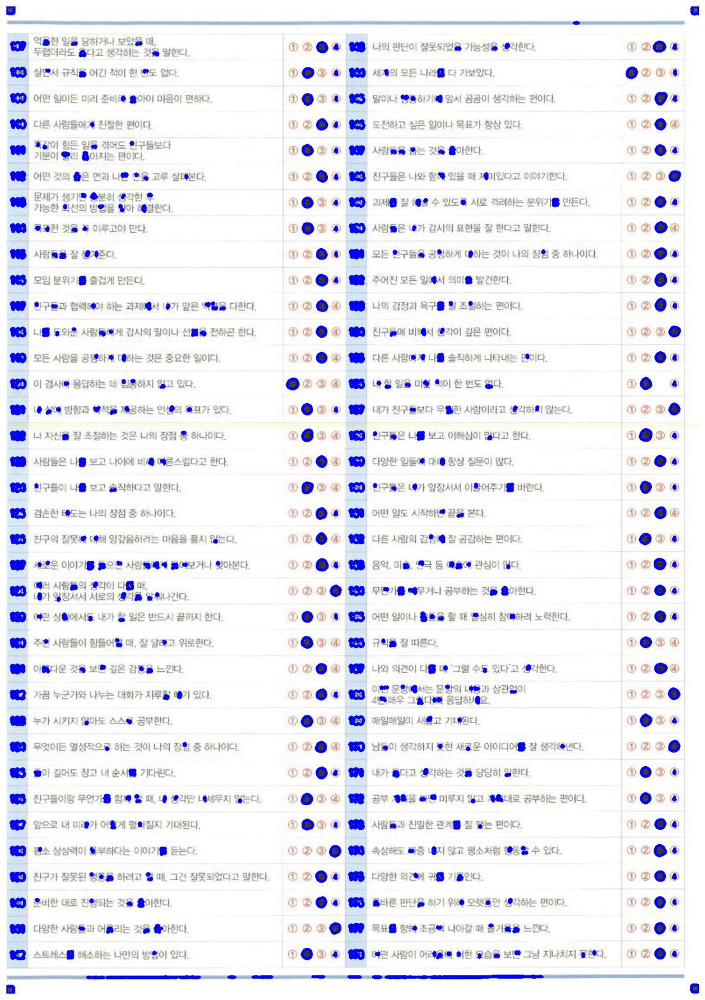

좌상단: (33, 28)
우상단: (1614, 32)
좌하단: (30, 2277)
우하단: (1613, 2278)


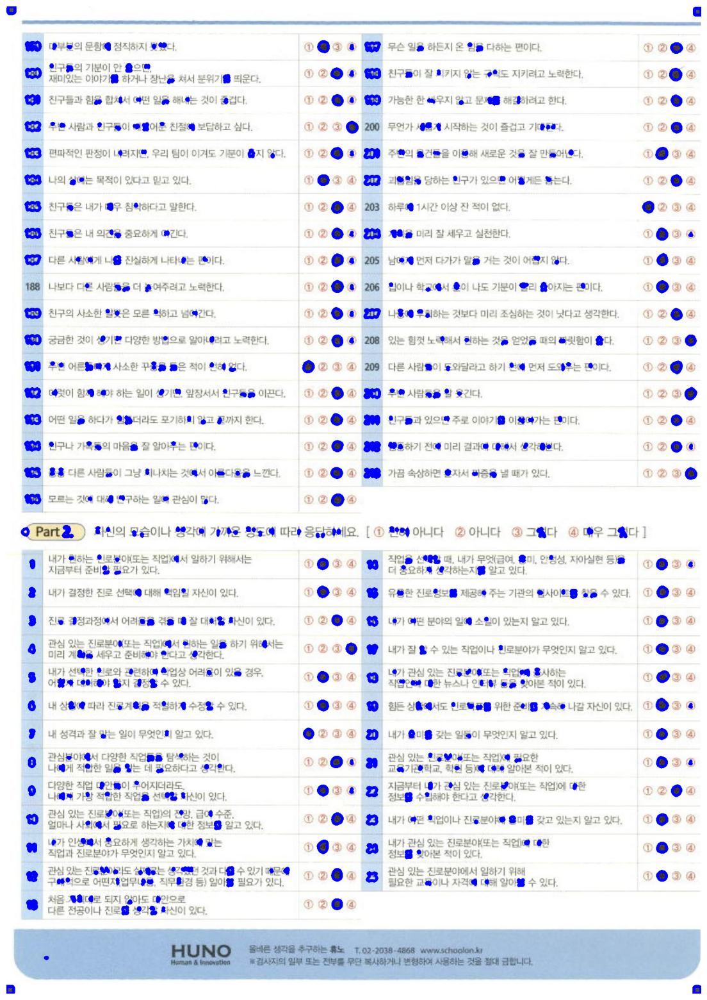

좌상단: (55, 32)
우상단: (1627, 29)
좌하단: (56, 2279)
우하단: (1633, 2278)


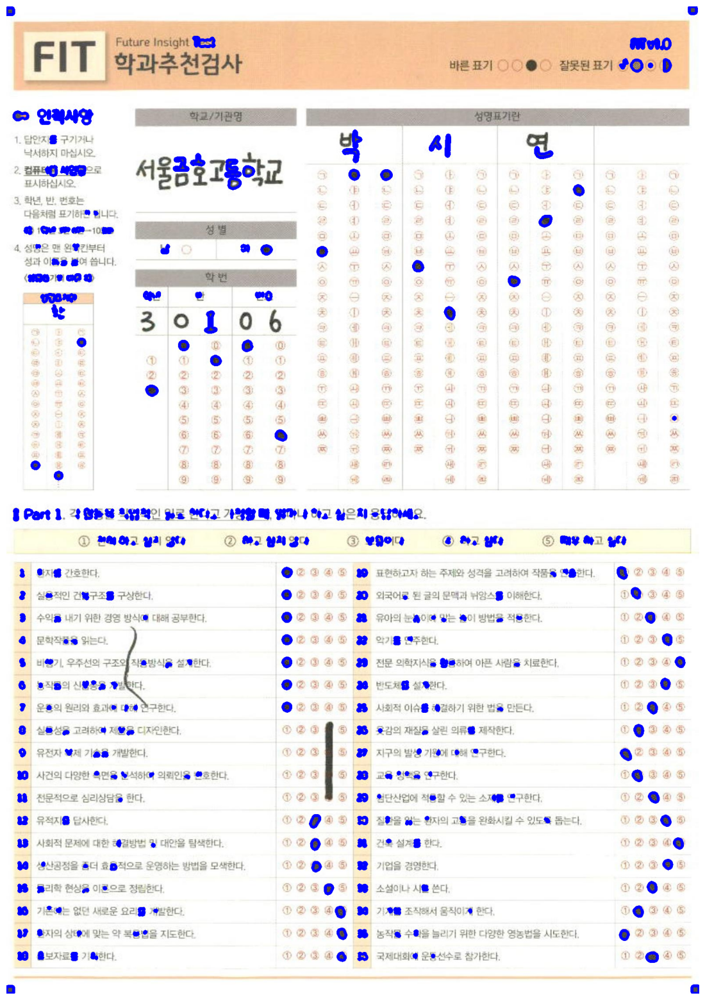

좌상단: (40, 29)
우상단: (1608, 29)
좌하단: (28, 2276)
우하단: (1606, 2278)


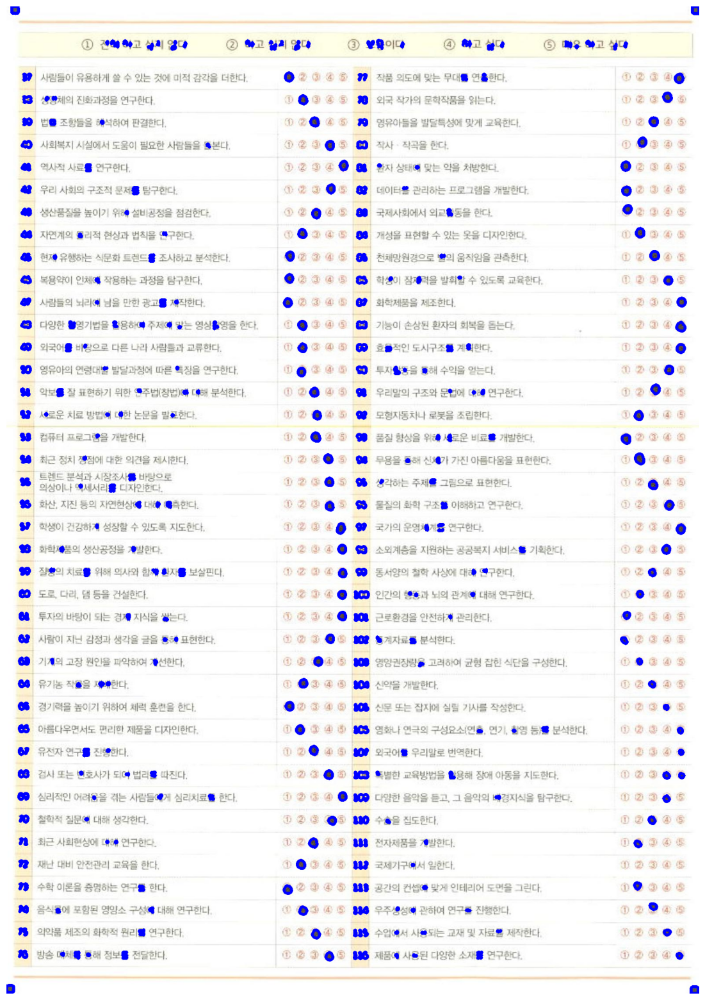

좌상단: (56, 29)
우상단: (1637, 31)
좌하단: (54, 2279)
우하단: (1666, 2304)


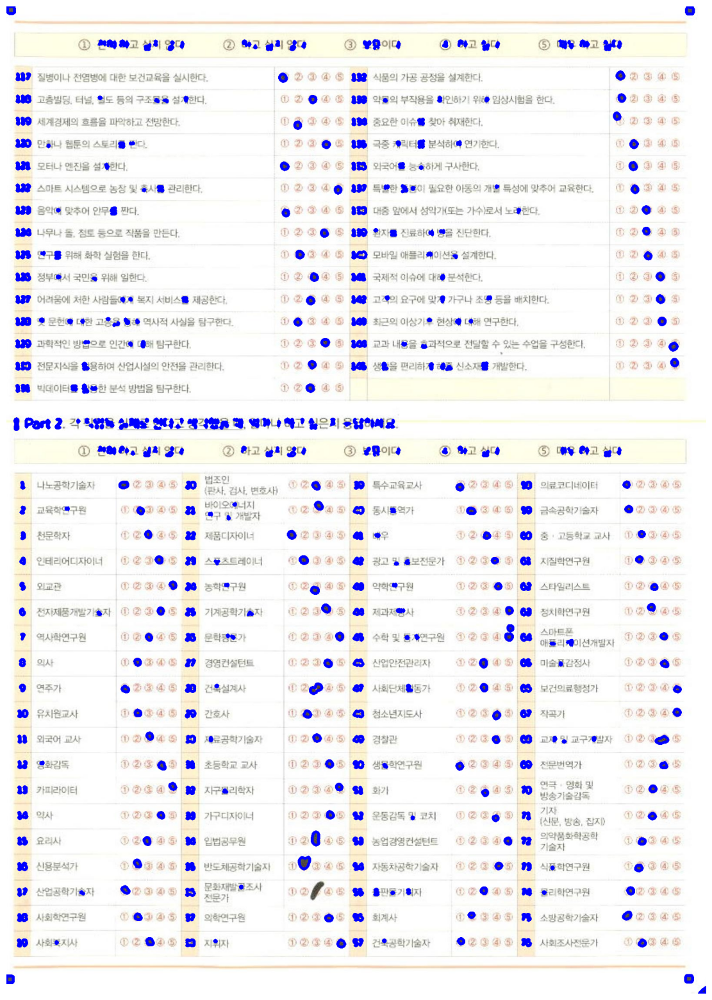

좌상단: (25, 30)
우상단: (1607, 32)
좌하단: (25, 2278)
우하단: (1608, 2278)


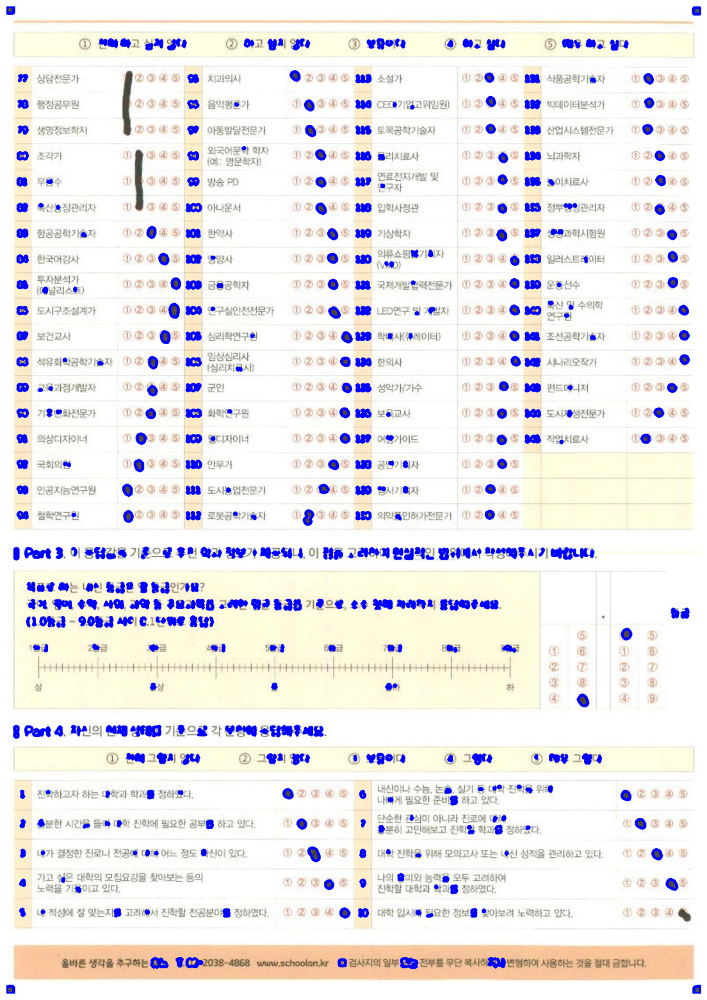

In [41]:
#### 최신버전
def is_square(cnt, min_area, max_area):
    epsilon = 0.02 * cv2.arcLength(cnt, True)
    approx = cv2.approxPolyDP(cnt, epsilon, True)
    
    # 정사각형은 꼭지점이 4개여야 함
    if len(approx) != 4:
        return False

    # 각도와 비율 체크
    for i in range(4):
        pt1 = approx[i][0]
        pt2 = approx[(i + 1) % 4][0]
        pt3 = approx[(i + 2) % 4][0]
        
        vec1 = pt2 - pt1
        vec2 = pt3 - pt2
        
        dot_product = vec1[0] * vec2[0] + vec1[1] * vec2[1]
        magnitude1 = np.sqrt(vec1[0]**2 + vec1[1]**2)
        magnitude2 = np.sqrt(vec2[0]**2 + vec2[1]**2)
        
        cos_angle = dot_product / (magnitude1 * magnitude2)
        angle = np.arccos(cos_angle) * (180 / np.pi)
        
        if angle < 80 or angle > 100:  # 각도가 직각에 가까운지 체크
            return False
    
    # 가로와 세로의 길이가 거의 같은지 확인
    x, y, w, h = cv2.boundingRect(approx)
    if abs(w - h) > min(w, h) * 0.1:  # 정사각형 비율이 아닌 경우 제외
        return False
    
    area = cv2.contourArea(cnt)
    if area < min_area or area > max_area:
        return False

    return True

def find_contour(image):
    # 그레이스케일 변환
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # 블러링을 통해 노이즈 제거
    blurred = cv2.GaussianBlur(gray, (9, 9), 0)

    # 바이너리 스레시홀딩
    _, binary = cv2.threshold(blurred, 180, 255, cv2.THRESH_BINARY_INV)

    # 외곽선 찾기
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    return contours

def draw_contours(image_folder, output_folder, min_area=100, max_area=1000):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    for filename in os.listdir(image_folder):
        if (filename.endswith('.jpg')) and ("_page" not in filename):
            image_path = os.path.join(image_folder, filename)
            image = cv2.imread(image_path)
            
            hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
            lower_red1 = np.array([0, 150, 150])
            upper_red1 = np.array([10, 255, 255])
            lower_red2 = np.array([170, 150, 150])
            upper_red2 = np.array([180, 255, 255])
            mask1 = cv2.inRange(hsv, lower_red1, upper_red1)
            mask2 = cv2.inRange(hsv, lower_red2, upper_red2)
            mask = cv2.bitwise_or(mask1, mask2)
            image[mask > 0] = [255, 255, 255]

            contours = find_contour(image)

            # 색칠된 동그라미만 남기기 위해 필터링
            filtered_contours = [cnt for cnt in contours if (cv2.contourArea(cnt) > 10) and (cv2.contourArea(cnt) < 500)]
            
            top_left = (float('inf'), float('inf'))
            top_right = (float('-inf'), float('inf'))
            bottom_left = (float('inf'), float('-inf'))
            bottom_right = (float('-inf'), float('-inf'))

            height, width = image.shape[:2]
            # 각 사각형의 꼭짓점 비교
            # vertex_list = filtered_contours[:10] + filtered_contours[-10:]
            for contour in filtered_contours:
                x, y, w, h = cv2.boundingRect(contour)
                if ((x < 15) or (y < 15)) or ((x > width - 15) or (y > height - 15)):
                    continue
                points = [(x, y), (x + w, y), (x, y + h), (x + w, y + h)]
                
                for point in points:
                    if point[0] + point[1] < top_left[0] + top_left[1]:
                        top_left = point
                    if point[0] - point[1] > top_right[0] - top_right[1]:
                        top_right = point
                    if point[0] - point[1] < bottom_left[0] - bottom_left[1]:
                        bottom_left = point
                    if point[0] + point[1] > bottom_right[0] + bottom_right[1]:
                        bottom_right = point

            print("좌상단:", top_left)
            print("우상단:", top_right)
            print("좌하단:", bottom_left)
            print("우하단:", bottom_right)

            # 네 점을 사용하여 이미지를 자르기 위한 사각형 정의
            x_min = min(top_left[0], bottom_left[0])            # min
            x_max = max(top_right[0], bottom_right[0])          # max
            y_min = min(top_left[1], top_right[1])              # min
            y_max = max(bottom_left[1], bottom_right[1])        # max    
            cropped_image = image[y_min:y_max, x_min:x_max]
            
            contours = find_contour(cropped_image)
            filtered_contours = [cnt for cnt in contours if (cv2.contourArea(cnt) > 10) and (cv2.contourArea(cnt) < 500)]
            #####################
            # gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            # blurred = cv2.GaussianBlur(gray, (3, 3), 0)

            # # 경계 검출 (Canny Edge Detection)
            # edges = cv2.Canny(blurred, 50, 100) # 50 100

            # # 윤곽선 검출
            # contours, _ = cv2.findContours(edges.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            # # 사각형 및 크기 필터링
            # rectangles = [cnt for cnt in contours if is_square(cnt, min_area, max_area)]
            #####################
            # rectangles = rectangles[:2] + rectangles[-2:]
            # print(filename)
            # print(rectangles)
            # # 원본 이미지에 윤곽선 그리기
            # # x 좌표와 y 좌표가 가장 작은 점이 좌상단 (top-left).
            # # x 좌표는 크지만 y 좌표가 작은 점이 우상단 (top-right).
            # # x 좌표는 작지만 y 좌표가 큰 점이 좌하단 (bottom-left).
            # # x 좌표와 y 좌표가 모두 큰 점이 우하단 (bottom-right).
            # cut_xy = []
            # for rdx, rect in enumerate(rectangles):
            #     x, y, w, h = cv2.boundingRect(rect)
            #     if rdx == 0: # 우하단
            #         cut_xy += [x + w]
            #         cut_xy += [y + h]
            #     if rdx == 3: # 좌상단
            #         cut_xy = [x, y] + cut_xy
            #     # cv2.rectangle(img, (x, y), (x + w, y + h), (0, 0, 255), 5)
            # cut_xy = tuple(cut_xy)
            # img = img[cut_xy[1]:cut_xy[3], cut_xy[0]:cut_xy[2]]
            
            # 결과 이미지 저장
            # result_image_path = os.path.join(output_folder, f"square_{filename}")
            result_image_path = os.path.join(output_folder, f"{filename}")
            cv2.imwrite(result_image_path, cropped_image)
            cv2.drawContours(cropped_image, filtered_contours, -1, (255, 0, 0), 5)
            plt.figure(figsize=(20, 20))
            plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
            plt.axis('off')
            plt.show()
            # cropped_image.save(result_image_path)
            
    return filtered_contours

# 사용 예시
# image_output_folder = './scan/datas/pdf/divided/t2'
# contour_output_folder = './scan/datas/pdf/square/t2'  # 네모를 기준으로 자른 사진을 저장할 폴더 경로
image_output_folder = './scan/datas/pdf/divided/test'  # PDF 파일이 있는 폴더 경로
contour_output_folder = './scan/datas/pdf/square/test'  # 출력 이미지 파일을 저장할 폴더 경로

# 이미지에서 윤곽선 검출 및 그리기
filtered_contours = draw_contours(image_output_folder, contour_output_folder)

In [40]:
#### 최신버전2
rects_point_dict = dict()

rects_point_dict['CLS_검사지(중고등)'] = {}
rects_point_dict['CLS_검사지(중고등)'][1] = [[276, 430, 634, 476], [276, 545, 635, 593], [281, 779, 337, 909], [352, 759, 484, 1109], [496, 761, 632, 1104], [663, 371, 875, 1104], [877, 367, 1089, 1107], [1093, 365, 1311, 1100], [1315, 371, 1544, 1103], [585, 1321, 772, 1611], [1353, 1323, 1531, 1656], [763, 1743, 1337, 2173]]
rects_point_dict['CLS_검사지(중고등)'][2] = [[795, 76, 1279, 1029], [617, 1245, 800, 1649], [1383, 1248, 1559, 1663], [737, 1811, 808, 2176], [1503, 1800, 1555, 2188]]
rects_point_dict['CLS_검사지(중고등)'][3] = [[700, 139, 783, 493], [1467, 123, 1535, 416], [579, 639, 771, 2184], [1348, 636, 1535, 2184]]
rects_point_dict['CLS_검사지(중고등)'][4] = [[617, 128, 803, 2107], [1375, 125, 1557, 2101]]

rects_point_dict['CLS_검사지(초등)'] = {}
rects_point_dict['CLS_검사지(초등)'][1] = [[276, 545, 636, 593], [284, 780, 332, 1015], [349, 755, 488, 1105], [496, 757, 628, 1107], [661, 369, 869, 1105], [880, 373, 1089, 1097], [1100, 368, 1301, 1101], [1312, 367, 1528, 1112], [516, 1311, 775, 1659], [1288, 1313, 1531, 1613], [812, 1793, 1307, 2133]]
rects_point_dict['CLS_검사지(초등)'][2] = [[793, 77, 1296, 1035], [608, 1253, 807, 1712], [1376, 1252, 1559, 1712], [733, 1881, 805, 2180], [1499, 1881, 1559, 2179]]
rects_point_dict['CLS_검사지(초등)'][3] = [[700, 124, 775, 951], [1467, 123, 1533, 812], [573, 1097, 777, 2185], [1341, 1097, 1537, 2176]]
rects_point_dict['CLS_검사지(초등)'][4] = [[605, 129, 803, 2100], [1364, 124, 1559, 2035]]

rects_point_dict['FIT'] = {}
rects_point_dict['FIT'][1] = [[284, 527, 656, 580], [297, 780, 353, 909], [364, 744, 505, 1096], [515, 751, 648, 1104], [679, 359, 885, 1097], [893, 363, 1107, 1101], [1111, 357, 1325, 1101], [1328, 357, 1548, 1101], [599, 1263, 788, 2196], [1363, 1260, 1549, 2201]]
rects_point_dict['FIT'][2] = [[601, 131, 785, 2185], [1368, 131, 1553, 2193]]
rects_point_dict['FIT'][3] = [[599, 124, 780, 912], [1364, 123, 1548, 860], [239, 1067, 399, 2189], [625, 1063, 777, 2181], [1008, 1075, 1164, 2183], [1391, 1071, 1545, 2195]]
rects_point_dict['FIT'][4] = [[245, 135, 403, 1197], [628, 135, 779, 1189], [1011, 137, 1167, 1189], [1393, 125, 1543, 1013], [1191, 1397, 1331, 1609], [1355, 1395, 1481, 1611], [604, 1755, 788, 2104], [1364, 1756, 1548, 2099]]

rects_point_dict['POWER(중고등)'] = {}
rects_point_dict['POWER(중고등)'][1] = [[267, 387, 632, 443], [275, 504, 628, 556], [277, 736, 328, 888], [347, 716, 484, 1073], [495, 716, 629, 1069], [656, 328, 872, 1065], [883, 329, 1088, 1069], [1093, 328, 1299, 1065], [1311, 331, 1523, 1071], [612, 1144, 769, 2180], [1372, 1144, 1521, 2177]]
rects_point_dict['POWER(중고등)'][2] = [[643, 56, 800, 2183], [1408, 45, 1553, 2188]]
rects_point_dict['POWER(중고등)'][3] = [[613, 56, 767, 2188], [1373, 55, 1530, 2179]]
rects_point_dict['POWER(중고등)'][4] = [[637, 53, 796, 1155], [1407, 45, 1551, 1091], [645, 1228, 799, 2073], [1408, 1219, 1553, 2009]]

rects_point_dict['POWER(초등)'] = {}
rects_point_dict['POWER(초등)'][1] = [[273, 663, 633, 717], [277, 897, 337, 1168], [347, 877, 489, 1229], [493, 877, 625, 1225], [656, 491, 864, 1233], [875, 488, 1092, 1228], [1097, 484, 1303, 1232], [1315, 485, 1524, 1239], [585, 1344, 764, 2163], [1356, 1347, 1528, 2156]]
rects_point_dict['POWER(초등)'][2] = [[615, 217, 795, 2093], [1384, 219, 1553, 2091]]
rects_point_dict['POWER(초등)'][3] = [[585, 220, 771, 2089], [1353, 213, 1540, 2096]]
rects_point_dict['POWER(초등)'][4] = [[617, 125, 796, 1109], [1381, 120, 1553, 1053], [652, 1224, 765, 2039], [1412, 1217, 1524, 1975]]

In [398]:
#### 최신버전2
def is_in_sector(cnt, project_name, page, circle_point_dict):
    x, y, radius = cnt
    page = int(page)
    
    circle_left = x - radius
    circle_top = y - radius
    circle_right = x + radius
    circle_bottom = y + radius
    
    # 원이 사각형 내부에 완전히 포함되는지 확인
    pass_point = False
    for rdx, rect_point in enumerate(rects_point_dict[project_name][page]):
        sector = rdx+1
        left, top, right, bottom = rect_point
        if (circle_left >= left and
            circle_top >= top and
            circle_right <= right and
            circle_bottom <= bottom):
            pass_point = True
            if project_name not in circle_point_dict:
                circle_point_dict[project_name] = {}
            if page not in circle_point_dict[project_name]:
                circle_point_dict[project_name][page] = {}
            if sector not in circle_point_dict[project_name][page]:
                circle_point_dict[project_name][page][sector] = []
            
            circle_point_dict[project_name][page][sector].append([x, y, radius])
            break
        
    if not pass_point:
        return False
    
    return True
    

def draw_contours(image_folder, output_folder): # 여기는 문제 없음
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    circle_point_dict = dict()
    for filename in os.listdir(image_folder):
        if (filename.endswith('.jpg')) and ("_page" not in filename):
            project_name_page = filename.replace('.jpg', '')
            splited_project_name_page = project_name_page.split('_')
            project_name = "_".join(splited_project_name_page[:-1])
            page = splited_project_name_page[-1]
            
            image_path = os.path.join(image_folder, filename)
            image = cv2.imread(image_path)
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            # 가우시안 블러로 노이즈 감소
            gray = cv2.GaussianBlur(gray, (9, 9), 0)

            # HoughCircles 함수를 사용하여 원 검출
            all_circles = cv2.HoughCircles(gray, cv2.HOUGH_GRADIENT, dp=1.0, minDist=20,
                                    param1=50, param2=20, minRadius=9, maxRadius=12)
            # all_circles = all_circles.astype(int)
            # circles = [(x,y,10) for cnt_list in all_circles for (x,y,r) in cnt_list if is_in_sector((x,y,r), project_name, page, circle_point_dict)]
            if all_circles is not None:
                all_circles = np.round(all_circles[0, :]).astype("int")
                circles = [(x, y, 10) for x, y, r in all_circles if is_in_sector((x, y, r), project_name, page, circle_point_dict)]
            
            # 원이 검출되었는지 확인
            if circles is not None:
                for (x, y, r) in circles:
                    
                    cv2.circle(image, (x, y), r, (255, 0, 0), 2)
                    # # 중심점 그리기
                    # cv2.circle(image, (x, y), 2, (0, 0, 255), 3)

            # 결과 이미지 저장
            # result_image_path = os.path.join(output_folder, f"circles_{filename}")
            result_image_path = os.path.join(output_folder, f"{filename}")
            cv2.imwrite(result_image_path, image)
            # plt.figure(figsize=(20, 20))
            # plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            # plt.axis('off')
            # plt.show()
    return circle_point_dict

image_output_folder = './scan/datas/pdf/square/t2' 
contour_output_folder = './scan/datas/pdf/circles/t2'  # 동그라미 검출 이미지를 저장할 폴더 경로

# 이미지에서 윤곽선 검출 및 그리기
circle_point_dict = draw_contours(image_output_folder, contour_output_folder)
circle_point_dict = {k: v for k, v in sorted(circle_point_dict.items())}
circle_point_dict = {k: {sk: sv for sk, sv in sorted(v.items())} for k, v in circle_point_dict.items()}
circle_point_dict = {k: {sk: {ssk: ssv for ssk, ssv in sorted(sv.items())} for sk, sv in v.items()} for k, v in circle_point_dict.items()}


---

In [399]:
project_dict = dict()
for project_name, pages_dict in circle_point_dict.items():
    project_df = pd.DataFrame()
    for page, sector_dict in pages_dict.items():
        page_df = pd.DataFrame()
        for sector, circle_list in sector_dict.items():
            df = pd.DataFrame(circle_list, columns=['x', 'y', 'r'])
            df['page'] = page
            df['sector'] = sector
            page_df = pd.concat([page_df, df], axis = 0).reset_index(drop=True)
        project_df = pd.concat([project_df, page_df], axis = 0).reset_index(drop=True)
        
    # circle_image_list = []
    # for filename in os.listdir('./scan/datas/pdf/circles/t1'):
    #     if (filename.endswith('.jpg')) and (project_name in filename):
    #         circle_image_list += [filename]
            
    # real_image_list = []
    # for filename in os.listdir('./scan/datas/PU'):
    #     if (filename.endswith('.jpg')) and ("page" in filename):
    #         real_image_list += [filename]
            
    sorted_df = pd.DataFrame()
    for idx, small_df in project_df.groupby(['page', 'sector']):
        sorted_small_df = small_df.sort_values(by='y')
        sorted_df = pd.concat([sorted_df, sorted_small_df], axis = 0).reset_index(drop = True)
                
    xy_sorted_df = pd.DataFrame()

    y_current = sorted_df['y'][0]
    y_question_num_list = []
    y_chk_equal_question_num = [1]
    y_list = sorted_df['y'][1:]

    for ydx, y in enumerate(y_list):
        if (abs(y_current - y) > 20) or (ydx == len(y_list)-1):
            y_question_num_list += y_chk_equal_question_num
            y_chk_equal_question_num = [y_chk_equal_question_num[-1]+1]
        else:
            y_chk_equal_question_num += [y_chk_equal_question_num[0]]
        y_current = y
    sorted_df['question_num'] = y_question_num_list + [y_question_num_list[-1]]

    for ddx, small_df in sorted_df.groupby('question_num'):
        small_df = small_df.sort_values('x').reset_index(drop=True)
        small_df['choices_count'] = [i+1 for i in range(len(small_df))]
        xy_sorted_df = pd.concat([xy_sorted_df, small_df], axis=0)
        
    xy_sorted_df = xy_sorted_df.reset_index(drop = True)
    json_df = xy_sorted_df.to_json(orient='columns')
    project_dict[project_name] = json.loads(json_df)          

In [372]:
# with open('./scan/datas/json/project_dict.json', 'w') as f:
#     json.dump(project_dict, f, ensure_ascii=False, indent=4)

In [400]:
project_dict.keys()

dict_keys(['CLS_검사지(중고등)', 'CLS_검사지(초등)', 'FIT', 'POWER(중고등)', 'POWER(초등)'])

In [401]:
circle_image_list = []
# project_name = 'POWER(중고등)'
project_name = 'FIT'
for filename in os.listdir('./scan/datas/pdf/circles/t2'):
    if (filename.endswith('.jpg')) and (project_name in filename):
        circle_image_list += [filename]

In [402]:
real_image_list = []
# file_path = './scan/datas/PU'
file_path = './scan/datas/FIT'
for filename in os.listdir(file_path):
    if (filename.endswith('.jpg')) and ("page" in filename):
        real_image_list += [f"{file_path}/{filename}"]

In [403]:
circle_image_list

['FIT_1.jpg', 'FIT_2.jpg', 'FIT_3.jpg', 'FIT_4.jpg']

In [404]:
real_image_list

['./scan/datas/FIT/page1.jpg',
 './scan/datas/FIT/page2.jpg',
 './scan/datas/FIT/page3.jpg',
 './scan/datas/FIT/page4.jpg']

---

---

---

In [43]:
def is_in_circle(shifted_cnt, project_name, page, wh_ratio, where_in_real_circle_dict):
    (x, y), radius = cv2.minEnclosingCircle(shifted_cnt)
    r = int(radius)//2
    page = int(page)
    
    
    
    # 원의 경계 좌표
    circle_left = x - r
    circle_top = y - r
    circle_right = x + r
    circle_bottom = y + r

    # 원이 사각형 내부에 완전히 포함되는지 확인
    pass_point = False
    for rdx, rect_point in enumerate(wh_ratio):
        sector = rdx+1
        left, top, right, bottom = rect_point
        if (circle_left >= left and
            circle_top >= top and
            circle_right <= right and
            circle_bottom <= bottom):
            pass_point = True
            if project_name not in where_in_real_circle_dict:
                where_in_real_circle_dict[project_name] = {}
            if page not in where_in_real_circle_dict[project_name]:
                where_in_real_circle_dict[project_name][page] = {}
            if sector not in where_in_real_circle_dict[project_name][page]:
                where_in_real_circle_dict[project_name][page][sector] = []
                
            where_in_real_circle_dict[project_name][page][sector].append([x, y, radius, shifted_cnt])
            break
    
    if not pass_point:
        return False
    
    return True

def find_contour(image):
    # 그레이스케일 변환
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # 블러링을 통해 노이즈 제거
    blurred = cv2.GaussianBlur(gray, (9, 9), 0)

    # 바이너리 스레시홀딩
    _, binary = cv2.threshold(blurred, 180, 255, cv2.THRESH_BINARY_INV)

    # 외곽선 찾기
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    return contours


# origin_image_list = [f"{project_name}_{i}.jpg" for i in range(1,5)]
where_in_real_circle_dict = dict()
page_ratio_dict = dict()
for idx, (image, origin_image) in enumerate(zip(real_image_list, circle_image_list)):
    page = idx+1
    image = cv2.imread(image)
    origin_image = cv2.imread(f'./scan/datas/pdf/circles/t2/{origin_image}')
    
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_red1 = np.array([0, 150, 150])
    upper_red1 = np.array([10, 255, 255])
    lower_red2 = np.array([170, 150, 150])
    upper_red2 = np.array([180, 255, 255])
    mask1 = cv2.inRange(hsv, lower_red1, upper_red1)
    mask2 = cv2.inRange(hsv, lower_red2, upper_red2)
    mask = cv2.bitwise_or(mask1, mask2)
    image[mask > 0] = [255, 255, 255]
    
    contours = find_contour(image)

    # 색칠된 동그라미만 남기기 위해 필터링
    filtered_contours = [cnt for cnt in contours if (cv2.contourArea(cnt) > 10) and (cv2.contourArea(cnt) < 500)]
    ############################################################################################################
    # rectangles = filtered_contours[:10] + filtered_contours[-10:]
    # rect_dict = dict()

    # for rdx, rect in enumerate(filtered_contours):
    #     x, y, w, h = cv2.boundingRect(rect)
    #     rect_dict[rdx] = [x, y, w, h]

    # max_sum = float('-inf')
    # min_sum = float('inf')

    # for key, (x, y, w, h) in rect_dict.items():
    #     # if (x < 20) or (y < 20):
    #     #     continue
    #     # if ((x < 15) or (y < 15)) or ((x > width - 15) or (y > height - 15)):
    #     #     continue
    #     current_sum = x + y
    #     if current_sum > max_sum:
    #         max_sum = current_sum
    #         max_key = key
    #     if current_sum < min_sum:
    #         min_sum = current_sum
    #         min_key = key
            
    # print("x+y가 가장 큰 key:", max_key) # 우하단
    # print("x+y가 가장 작은 key:", min_key) # 좌상단

    # x, y = rect_dict[min_key][:2]
    # xw, yh = rect_dict[max_key][0] + rect_dict[max_key][2], rect_dict[max_key][1] + rect_dict[max_key][3]
    # cropped_image = image[y:yh, x:xw]
    # cropped_image = image[y-5:yh+5, x-5:xw+5]
    ############################################################################################################
    # # 사각형의 꼭짓점을 찾기 위한 변수 초기화
    top_left = (float('inf'), float('inf'))
    top_right = (float('-inf'), float('inf'))
    bottom_left = (float('inf'), float('-inf'))
    bottom_right = (float('-inf'), float('-inf'))

    height, width = image.shape[:2]
    # 각 사각형의 꼭짓점 비교
    for contour in filtered_contours:
        x, y, w, h = cv2.boundingRect(contour)
        if ((x < 15) or (y < 15)) or ((x > width - 15) or (y > height - 15)):
            continue
        points = [(x, y), (x + w, y), (x, y + h), (x + w, y + h)]
        
        for point in points:
            if point[0] + point[1] < top_left[0] + top_left[1]:
                top_left = point
            if point[0] - point[1] > top_right[0] - top_right[1]:
                top_right = point
            if point[0] - point[1] < bottom_left[0] - bottom_left[1]:
                bottom_left = point
            if point[0] + point[1] > bottom_right[0] + bottom_right[1]:
                bottom_right = point

    print("좌상단:", top_left)
    print("우상단:", top_right)
    print("좌하단:", bottom_left)
    print("우하단:", bottom_right)

    # 네 점을 사용하여 이미지를 자르기 위한 사각형 정의
    x_min = min(top_left[0], bottom_left[0])            # min
    x_max = max(top_right[0], bottom_right[0])          # max
    y_min = min(top_left[1], top_right[1])              # min
    y_max = max(bottom_left[1], bottom_right[1])        # max    
    cropped_image = image[y_min:y_max, x_min:x_max]

    # 수평 변위와 수직 변위 계산
    dx = top_left[0] - bottom_left[0]
    dy = bottom_left[1] - top_left[1]

    # 필요한 각도 계산 (라디안 단위에서 도 단위로 변환)
    theta = np.arctan2(dx, dy) * (180.0 / np.pi)

    print(f"좌하단의 x좌표를 좌상단의 x좌표와 동일하게 맞추기 위해 필요한 회전 각도: {theta:.2f}도")
    
    (h, w) = cropped_image.shape[:2]
    center = (w / 2, h / 2)
    M = cv2.getRotationMatrix2D(center, theta, 1.0)  # 5도 회전
    roteted_image = cv2.warpAffine(cropped_image, M, (w, h))
    
    # ############################################################################################################
    # plt.figure(figsize=(20, 20))
    # plt.imshow(cv2.cvtColor(roteted_image, cv2.COLOR_BGR2RGB))
    # plt.axis('off')
    # plt.show()
    contours = find_contour(cropped_image)

    # 색칠된 동그라미만 남기기 위해 필터링
    filtered_contours = [cnt for cnt in contours if (cv2.contourArea(cnt) > 10) and (cv2.contourArea(cnt) < 500)]

    height, width = cropped_image.shape[:2]
    origin_height, origin_width = origin_image.shape[:2]

    x_ratio_re = width / origin_width
    y_ratio_re = height/ origin_height
    x_ratio = origin_width / width
    y_ratio = origin_height/ height
    
    page_ratio_dict[page] = [x_ratio, y_ratio, x_ratio_re, y_ratio_re]
        
    wh_ratio = [[int(x * x_ratio_re), int(y * y_ratio_re), int(xw * x_ratio_re), int(yh * y_ratio_re)] 
                for (x, y, xw, yh) in rects_point_dict[project_name][page]]

    # x_edit = max(max(top_left[0], bottom_left[0]) - min(top_left[0], bottom_left[0]),
    # max(top_right[0], bottom_right[0]) - min(top_right[0], bottom_right[0]))
    
    # y_edit = max(max(top_left[1], top_right[1]) - min(top_left[1], top_right[1]),
    # max(bottom_left[1], bottom_right[1]) - min(bottom_left[1], bottom_right[1]))
    # print(x_edit, y_edit)
    
    # if theta > 0:
    #     x_edit *= -1
    #     y_edit *= -1
        
    
    shifted_contours = []
    for cnt in filtered_contours:
        shifted_cnt = np.array(cnt)
        # shifted_cnt[:, :, 0] += x_edit
        # shifted_cnt[:, :, 1] += y_edit
        if is_in_circle(shifted_cnt, project_name, page, wh_ratio, where_in_real_circle_dict):
            shifted_contours.append(shifted_cnt)
        
    # 원본 이미지에 외곽선 그리기
    output_image = cropped_image.copy()
    cv2.drawContours(output_image, shifted_contours, -1, (255, 0, 0), 1)

    for cnt in shifted_contours:
        M = cv2.moments(cnt)
        if M["m00"] != 0:
            cX = int(M["m10"] // M["m00"])
            cY = int(M["m01"] // M["m00"])
            cv2.circle(output_image, (cX, cY), 8, (0, 0, 255), -1)  # 중심에 빨간색 점 그리기

    # 결과 이미지 보기
    for x,y,xw,yh in wh_ratio:
        start_point = (x,y)
        end_point = (xw,yh)
        color = (0, 255, 0)  # 사각형 색상 (B, G, R) 형식
        thickness = 2  # 사각형 선 두께
        cv2.rectangle(output_image, start_point, end_point, color, thickness)

    plt.figure(figsize=(20, 20))
    plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()
    cv2.imwrite(f'./scan/datas/{idx}.jpg', output_image)
where_in_real_circle_dict = {k: v for k, v in sorted(where_in_real_circle_dict.items())}
where_in_real_circle_dict = {k: {sk: sv for sk, sv in sorted(v.items())} for k, v in where_in_real_circle_dict.items()}
where_in_real_circle_dict = {k: {sk: {ssk: ssv for ssk, ssv in sorted(sv.items())} for sk, sv in v.items()} for k, v in where_in_real_circle_dict.items()}

NameError: name 'real_image_list' is not defined

In [605]:
top_left = (24, 28)
top_right = (811, 30)
bottom_left = (20, 1150)
bottom_right = (809, 1153)

In [608]:
min(max(top_left[0], bottom_left[0]) - min(top_left[0], bottom_left[0]),
max(top_right[0], bottom_right[0]) - min(top_right[0], bottom_right[0]))

2

In [609]:
min(max(top_left[1], top_right[1]) - min(top_left[1], top_right[1]),
max(bottom_left[1], bottom_right[1]) - min(bottom_left[1], bottom_right[1]))

2

In [692]:
# x_ratio = origin_width / width
# y_ratio = origin_height/ height

dot_dict = dict()
all_circle_df = pd.DataFrame(project_dict[project_name])
print(project_name)
for project_name, pages_dict in where_in_real_circle_dict.items():
    project_df = pd.DataFrame()
    for page, sector_dict in pages_dict.items():
        page_df = pd.DataFrame()
        x_ratio, y_ratio = page_ratio_dict[page][:2]
        print(x_ratio, y_ratio)
        for sector, circle_list in sector_dict.items():
            ratio_circle_list = [[int(x * x_ratio), int(y * y_ratio), int(r), a*(x_ratio, y_ratio)] for (x, y, r, a) in circle_list]
            # ratio_circle_list = [[x * x_ratio, y * y_ratio, int(r), a*(x_ratio, y_ratio)] for (x, y, r, a) in circle_list]
            where_in_real_circle_dict[project_name][page][sector] = ratio_circle_list
            df = pd.DataFrame(ratio_circle_list, columns=['x', 'y', 'r', 'cnt'])
            df['page'] = page
            df['sector'] = sector
            page_df = pd.concat([page_df, df], axis = 0).reset_index(drop=True)
        project_df = pd.concat([project_df, page_df], axis = 0).reset_index(drop=True)
        
    marking_df = pd.DataFrame()
    for idx, small_df in project_df.groupby(['page', 'sector']):
        page, sector = idx
        sorted_small_df = small_df.sort_values(by='y')

        # page, sector 겹치는 애들로만
        # sorted_small_df['question_num'] = sorted_small_df['y'].apply(lambda y : page_sec_df.loc[(page_sec_df['y'] - y).abs().idxmin(), 'question_num'])
        # sorted_small_df['choices_count'] = sorted_small_df['x'].apply(lambda x : page_sec_df.loc[(page_sec_df['x'] - x).abs().idxmin(), 'choices_count'])   
        # marking_df = pd.concat([marking_df, sorted_small_df], axis = 0).reset_index(drop = True)
        
        for rdx, row in sorted_small_df.iterrows():
            page_sec_df = all_circle_df.loc[(all_circle_df['page'] == page) & (all_circle_df['sector'] == sector)]
            row = pd.DataFrame(row).transpose()
            # display(row)
            row['question_num'] = row['y'].apply(lambda y : page_sec_df.loc[(page_sec_df['y'] - y).abs().idxmin(), 'question_num'])
            page_sec_df = page_sec_df.loc[page_sec_df['question_num'] == row['question_num'].values[0]]
            row['choices_count'] = row['x'].apply(lambda x : page_sec_df.loc[(page_sec_df['x'] - x).abs().idxmin(), 'choices_count'])   
            
            marking_df = pd.concat([marking_df, row], axis = 0).reset_index(drop = True)
        
        

FIT
1.9734513274336283 1.9964444444444445
1.9784537389100127 1.9946714031971582
1.9809644670050761 1.9929015084294588
1.9809644670050761 1.9964444444444445


In [681]:
all_circle_df

,x,y,r,page,sector,question_num,choices_count
0,404,552,11,1,1,1,1
1,586,552,11,1,1,1,2
2,326,806,11,1,2,2,1
3,326,838,11,1,2,3,1
4,326,872,11,1,2,4,1
...,...,...,...,...,...,...,...
1803,1394,2060,11,4,8,418,1
1804,1426,2060,10,4,8,418,2
1805,1458,2060,10,4,8,418,3
1806,1488,2060,10,4,8,418,4


In [693]:
marking_df = marking_df.merge(all_circle_df[['x', 'y', 'r', 'question_num', 'choices_count']], how = 'inner', on = ['question_num', 'choices_count'])
marking_df.columns = ['x', 'y', 'r', 'cnt', 'page', 'sector', 'question_num', 'choices_count', 'circle_x', 'circle_y', 'circle_r']
marking_df

,x,y,r,cnt,page,sector,question_num,choices_count,circle_x,circle_y,circle_r
0,407,552,4,"[[[404.5575221238938, 543.0328888888889]], [[3...",1,1,1,1,404,552,11
1,328,839,4,"[[[325.61946902654864, 830.5208888888889]], [[...",1,2,3,1,326,838,11
2,401,771,5,"[[[398.6371681415929, 762.6417777777777]], [[3...",1,3,5,1,398,770,11
3,473,806,5,"[[[469.6814159292035, 796.5813333333333]], [[4...",1,3,6,2,472,804,11
4,545,772,5,"[[[542.6991150442478, 762.6417777777777]], [[5...",1,4,15,1,544,770,11
...,...,...,...,...,...,...,...,...,...,...,...
318,1452,1791,4,"[[[1450.0659898477156, 1782.8248888888888]], [...",4,8,414,3,1458,1792,11
319,1451,1858,4,"[[[1452.0469543147208, 1848.7075555555555]], [...",4,8,415,3,1458,1860,11
320,1452,1924,4,"[[[1450.0659898477156, 1916.5866666666666]], [...",4,8,416,3,1458,1926,10
321,1512,1991,4,"[[[1511.475888324873, 1982.4693333333335]], [[...",4,8,417,5,1520,1994,10


In [694]:
image_width = 100
image_height = 100
image_size = (image_height, image_width)
intersection_list = []

if 'intersection_ratio' in marking_df.columns:
    del marking_df['intersection_ratio']

for rdx, row in marking_df.iterrows():
    x, y, r, contour, page, sector, question_num, choices_count, circle_x, circle_y, circle_r = row.values
    # contour = contour.astype(int)
    contour = np.round(contour).astype(int)
    
    circle_img = np.zeros(image_size, np.uint8)
    contour_img = np.zeros(image_size, np.uint8)

    # 좌표를 이미지 내부로 변환
    adjusted_x = circle_x - (circle_x - 50)
    adjusted_y = circle_y - (circle_y - 50)

    # 원 그리기
    cv2.circle(circle_img, (adjusted_x, adjusted_y), circle_r, 255, -1)

    # 윤곽선 좌표 조정
    adjusted_contour = contour - [circle_x - 50, circle_y - 50]

    # 윤곽선 내부 채우기
    cv2.drawContours(contour_img, [adjusted_contour], -1, 255, -1)
    # plt.figure(figsize=(15, 15))
    # plt.imshow(cv2.cvtColor(contour_img, cv2.COLOR_BGR2RGB))
    # plt.axis('off')
    # plt.show()
    # 두 이미지를 AND 연산하여 교집합 영역 찾기
    intersection = cv2.bitwise_and(circle_img, contour_img)

    # 교집합 영역의 픽셀 수 계산
    intersection_area = np.sum(intersection == 255)

    # 원의 영역 계산
    circle_area = np.sum(circle_img == 255)

    # 교집합 비율 계산
    intersection_ratio = intersection_area / circle_area

    # print(f"교집합 비율: {intersection_ratio:.4f}")
    
    # if intersection_ratio > 0.6:
    #     pass_intersection_list.append(rdx)
# real_sorted_df = real_sorted_df.iloc[pass_intersection_list, :].reset_index(drop = True)

    intersection_list.append(intersection_ratio)
marking_df['intersection_ratio'] = intersection_list
marking_df

,x,y,r,cnt,page,sector,question_num,choices_count,circle_x,circle_y,circle_r,intersection_ratio
0,407,552,4,"[[[404.5575221238938, 543.0328888888889]], [[3...",1,1,1,1,404,552,11,0.668435
1,328,839,4,"[[[325.61946902654864, 830.5208888888889]], [[...",1,2,3,1,326,838,11,0.588859
2,401,771,5,"[[[398.6371681415929, 762.6417777777777]], [[3...",1,3,5,1,398,770,11,0.652520
3,473,806,5,"[[[469.6814159292035, 796.5813333333333]], [[4...",1,3,6,2,472,804,11,0.763926
4,545,772,5,"[[[542.6991150442478, 762.6417777777777]], [[5...",1,4,15,1,544,770,11,0.740053
...,...,...,...,...,...,...,...,...,...,...,...,...
318,1452,1791,4,"[[[1450.0659898477156, 1782.8248888888888]], [...",4,8,414,3,1458,1792,11,0.456233
319,1451,1858,4,"[[[1452.0469543147208, 1848.7075555555555]], [...",4,8,415,3,1458,1860,11,0.474801
320,1452,1924,4,"[[[1450.0659898477156, 1916.5866666666666]], [...",4,8,416,3,1458,1926,10,0.425868
321,1512,1991,4,"[[[1511.475888324873, 1982.4693333333335]], [[...",4,8,417,5,1520,1994,10,0.454259


In [581]:
all_circle_df.loc[(all_circle_df['question_num'] == 72) & (all_circle_df['choices_count'] >= 1)]

,x,y,r,page,sector,question_num,choices_count
182,1146,556,11,1,7,72,1
183,1218,556,11,1,7,72,2
184,1290,556,11,1,7,72,3


In [537]:
display(all_circle_df.loc[(all_circle_df['page'] == 1) & (all_circle_df['sector'] ==8)])
page_sec_df = all_circle_df.loc[(all_circle_df['page'] == 1) & (all_circle_df['sector'] ==8)]
print(marking_df.iloc[[15], :]['y'].apply(lambda y : page_sec_df.loc[(page_sec_df['y'] - y).abs().idxmin(), 'question_num']))
page_sec_df = page_sec_df.loc[page_sec_df['question_num'] == 72]
print(marking_df.iloc[[15], :]['x'].apply(lambda x : page_sec_df.loc[(page_sec_df['x'] - x).abs().idxmin(), 'choices_count']))

,x,y,r,page,sector,question_num,choices_count
228,1362,382,11,1,8,88,1
229,1436,382,11,1,8,88,2
230,1508,382,11,1,8,88,3
231,1362,418,11,1,8,89,1
232,1436,418,11,1,8,89,2
...,...,...,...,...,...,...,...
284,1508,1008,11,1,8,106,3
285,1436,1042,11,1,8,107,1
286,1508,1042,11,1,8,107,2
287,1436,1076,11,1,8,108,1


15    89
Name: y, dtype: int64


ValueError: attempt to get argmin of an empty sequence

In [538]:
marking_df.iloc[[15], :]

,x,y,r,cnt,page,sector,question_num,choices_count,circle_x,circle_y,circle_r,intersection_ratio
15,1073,420,4,"[[[1069.831847133758, 411.26755555555553]], [[...",1,6,47,3,1074,418,11,0.702918


In [583]:
marking_df.loc[marking_df['intersection_ratio'] < 0.5]

,x,y,r,cnt,page,sector,question_num,choices_count,circle_x,circle_y,circle_r,intersection_ratio
11,854,490,5,"[[[852.5309734513274, 479.14666666666665]], [[...",1,5,28,3,856,486,11,0.421751
31,628,1799,4,"[[[625.5840707964602, 1792.8071111111112]], [[...",1,9,119,1,630,1800,11,0.464191
53,1390,2005,4,"[[[1387.3362831858408, 1998.4408888888888]], [...",1,10,141,1,1394,2006,11,0.485411
127,1394,1690,4,"[[[1392.831432192649, 1681.5079928952043]], [[...",2,2,215,1,1394,1696,11,0.464191
130,1393,1843,4,"[[[1392.831432192649, 1835.0976909413855]], [[...",2,2,218,1,1394,1848,11,0.485411
132,1394,1945,4,"[[[1390.852978453739, 1938.8206039076379]], [[...",2,2,220,1,1394,1952,11,0.405836
182,327,2032,4,"[[[324.87817258883246, 2024.78793256433]], [[3...",3,3,270,3,322,2036,10,0.435331
184,273,2150,4,"[[[271.3921319796954, 2142.369121561668]], [[2...",3,3,272,1,268,2152,11,0.469496
201,653,2030,4,"[[[651.7373096446701, 2022.7950310559006]], [[...",3,4,289,1,650,2036,11,0.453581
202,653,2089,4,"[[[651.7373096446701, 2080.589174800355]], [[6...",3,4,290,1,650,2094,11,0.496021


In [540]:
marking_df.loc[(marking_df['page'] == 1) & (marking_df['sector'] == 6)]

,x,y,r,cnt,page,sector,question_num,choices_count,circle_x,circle_y,circle_r,intersection_ratio
15,1073,420,4,"[[[1069.831847133758, 411.26755555555553]], [[...",1,6,47,3,1074,418,11,0.702918
16,925,593,5,"[[[922.6802547770701, 584.9582222222223]], [[9...",1,6,52,1,928,592,11,0.718833
17,998,698,5,"[[[996.256050955414, 688.7733333333333]], [[99...",1,6,55,2,1000,696,11,0.673740


In [655]:
import math

# 원의 중심과 반지름
circle_center = (1520, 1994)
radius = 10

# 점의 좌표
point = (1512, 1991)

# 점과 원의 중심 사이의 거리 계산
distance = math.sqrt((circle_center[0] - point[0]) ** 2 + (circle_center[1] - point[1]) ** 2)

# 점이 원 안에 포함되는지 확인
if distance <= radius:
    print("점이 원 안에 포함됩니다.")
else:
    print("점이 원 안에 포함되지 않습니다.")

점이 원 안에 포함됩니다.


---

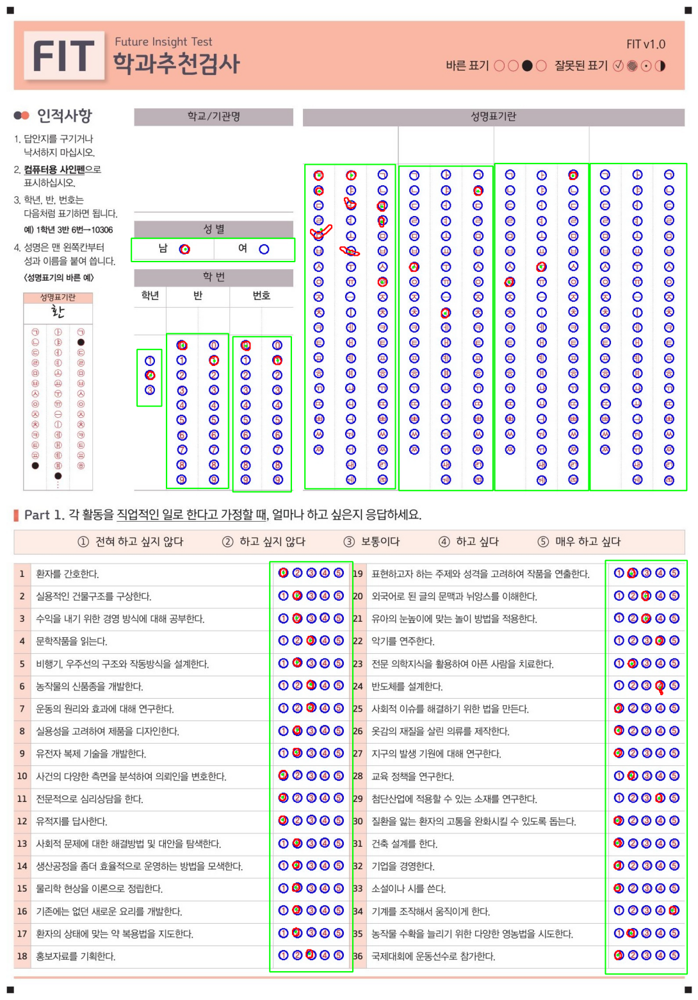

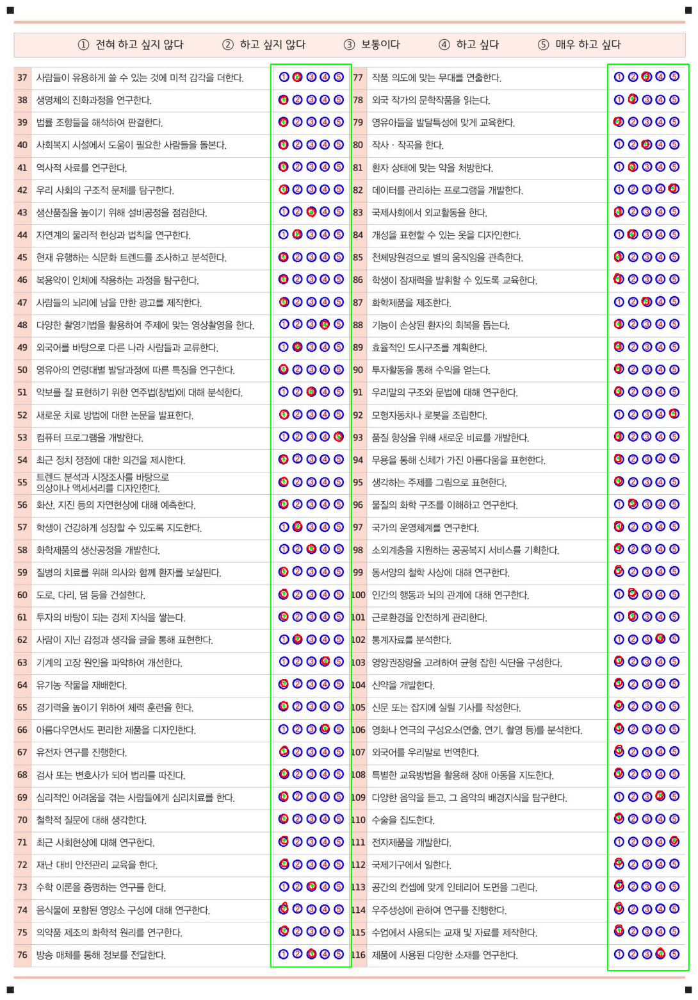

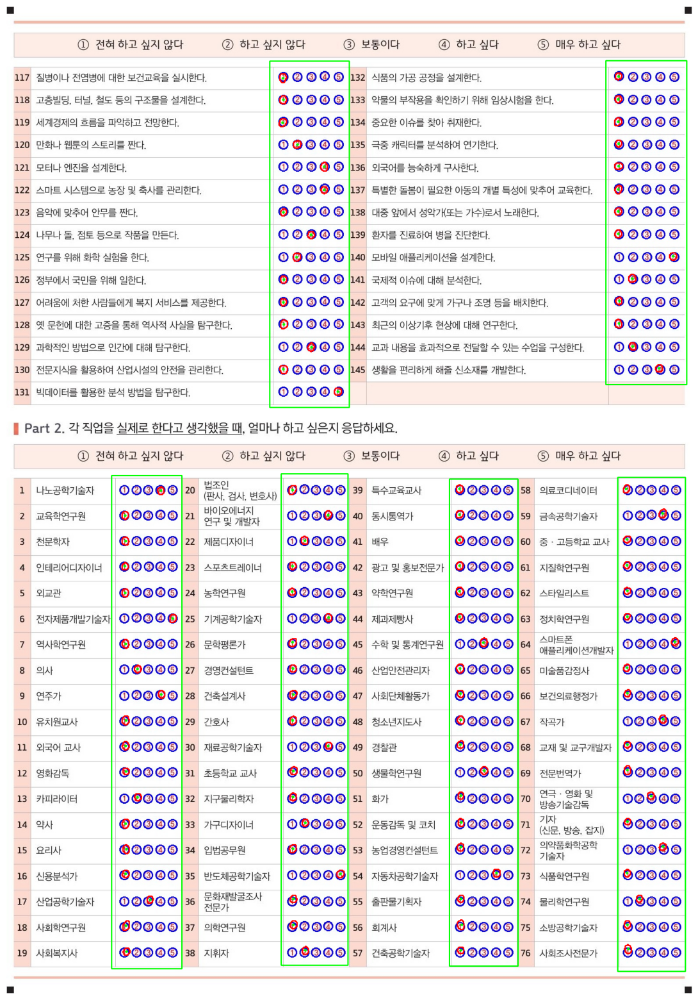

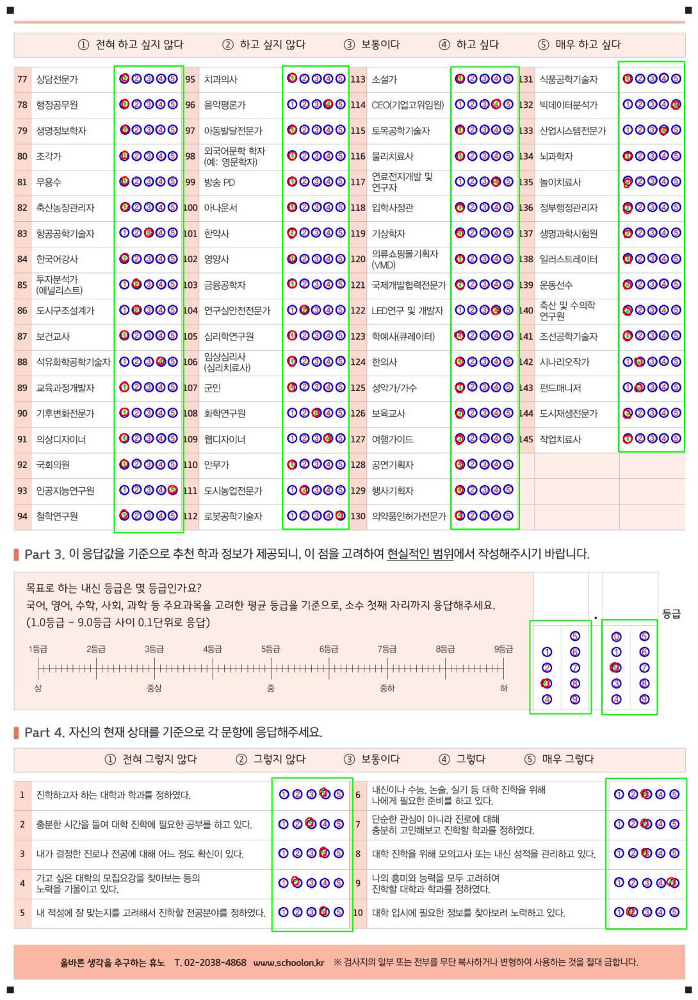

In [654]:
# real_dots = marking_df.loc[marking_df['intersection_ratio'] > 0.6, ['x','y']]
# real_dots = [v for v in real_dots.values]

# real_contour = real_sorted_df.loc[real_sorted_df['intersection_ratio'] > 0.6, 'a'].apply(lambda x : x.astype(int)).values
# cv2.drawContours(origin_image, real_contour, -1, (255, 0, 0), 1)

for page, origin_image in enumerate(circle_image_list):
    page = page+1
    origin_image = cv2.imread(f'./scan/datas/pdf/circles/t2/{origin_image}')
    page_df = marking_df.loc[marking_df['page'] == page]
    # real_dots = page_df.loc[page_df['intersection_ratio'] >= 0.5, ['x','y', 'cnt']]
    real_dots = page_df.loc[:, ['x','y', 'cnt']]
    r = real_dots
    real_dots = [v[:2] for v in real_dots.values]
    real_cnt = r['cnt'].apply(lambda x : x.astype(int)).values
    
    # real_contour = [v[-1] for v in real_dots.values]
    
    img = origin_image.copy()
    for cnt in real_dots:
        cv2.circle(img, cnt, 3, (0, 255, 0), -1)  # 중심에 빨간색 점 그리기

    cv2.drawContours(img, real_cnt, -1, (0, 0, 255), 2)

    for x,y,xw,yh in rects_point_dict[project_name][page]:
        start_point = (x,y)
        end_point = (xw,yh)
        color = (0, 255, 0)
        thickness = 2
        cv2.rectangle(img, start_point, end_point, color, thickness)
    
    plt.figure(figsize=(20, 20))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

---

In [ ]:
sector_num = 0
df = pd.DataFrame(circle_point_dict[filename][sector_num], columns=['x', 'y', 'r'])
real_df = pd.DataFrame(where_in_real_circle_dict[sector_num], columns=['x', 'y', 'r', 'a'])

sorted_df = df.sort_values(by='y').reset_index(drop = True)
real_sorted_df = real_df.sort_values(by='y').reset_index(drop = True)

In [ ]:
xy_sorted_df = pd.DataFrame()

y_current = sorted_df['y'][0]
y_question_num_list = []
y_chk_equal_question_num = [1]
y_list = sorted_df['y'][1:]

for ydx, y in enumerate(y_list):
    if (abs(y_current - y) > 20) or (ydx == len(y_list)-1):
        y_question_num_list += y_chk_equal_question_num
        y_chk_equal_question_num = [y_chk_equal_question_num[-1]+1]
    else:
        y_chk_equal_question_num += [y_chk_equal_question_num[0]]
    y_current = y
sorted_df['question_num'] = y_question_num_list + [y_question_num_list[-1]]

for ddx, small_df in sorted_df.groupby('question_num'):
    small_df = small_df.sort_values('x').reset_index(drop=True)
    small_df['choices_count'] = [i+1 for i in range(len(small_df))]
    xy_sorted_df = pd.concat([xy_sorted_df, small_df], axis=0)
xy_sorted_df = xy_sorted_df.reset_index(drop = True)
xy_sorted_df 

In [ ]:
real_sorted_df['question_num'] = real_sorted_df['y'].apply(lambda y : xy_sorted_df.loc[(xy_sorted_df['y'] - y).abs().idxmin(), 'question_num'])
real_sorted_df['choices_count'] = real_sorted_df['x'].apply(lambda x : xy_sorted_df.loc[(xy_sorted_df['x'] - x).abs().idxmin(), 'choices_count'])
real_sorted_df

---

In [ ]:
position = (50, 50)  # 텍스트의 시작 위치 (x, y)
font = cv2.FONT_HERSHEY_SIMPLEX  # 폰트 종류
font_scale = 1  # 폰트 크기
color = (255, 0, 0)  # 텍스트 색상 (B, G, R)
thickness = 4  # 텍스트 두께
for cdx, (x, y, r, _, _) in enumerate(xy_sorted_df.values):
    position = (int(x)-200, int(y))
    cv2.putText(origin_image, str(cdx), position, font, font_scale, color, thickness)
    
plt.figure(figsize=(20, 20))
plt.imshow(cv2.cvtColor(origin_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()